In [1]:
import tensorflow as tf
from tensorflow import keras
import tensorflow_addons as tfa

In [2]:
import numpy as np
import matplotlib.pyplot as plt

import urllib
import cv2

In [3]:
config = {
    'LR': 0.01,
    'PYRAMID_SIZE': 1.4,
    'DEFAULT_STEPS': 1000,
    'PYRAMID_STEPS': 200,
    'DPI': 300
}

In [4]:
# Download an image and read it into a NumPy array.
def url_to_array(url):
    req = urllib.request.urlopen(url)
    arr = np.array(bytearray(req.read()), dtype=np.int8)
    img = cv2.imdecode(arr, -1)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    return img

def deprocess(img, backbone):
    if backbone == 'inceptionv3':
        return tf.cast(255*(img + 1.0)/2.0, tf.uint8)
    elif backbone == 'resnet50' or backbone == 'vgg19':
        means = np.array([103.939, 116.779, 123.68])
        img = img + means
        img = img[:, :, ::-1]
        img = np.clip(img, 0, 255).astype('uint8')
        return tf.cast(img, tf.uint8)
    

def display_img(img):
    fig, ax = plt.subplots(figsize=(img.shape[0]/config['DPI'], img.shape[1]/config['DPI']), 
                           dpi=config['DPI'])
    ax.imshow(img)
    ax.axis('off')
    plt.show()

In [5]:
url = 'https://storage.googleapis.com/download.tensorflow.org/example_images/YellowLabradorLooking_new.jpg'
dog_img = url_to_array(url)

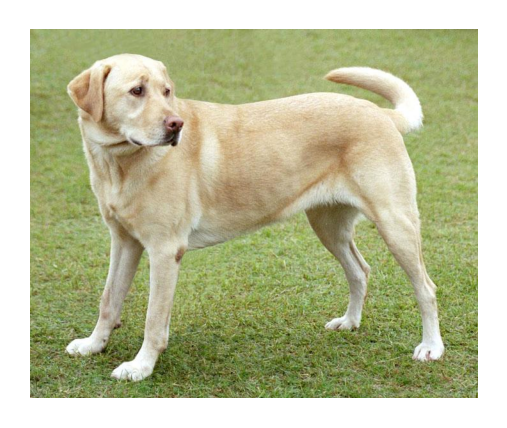

In [6]:
display_img(dog_img)

In [7]:
# Take a look at each backbone and decide on some layers to expose!
tf.keras.applications.InceptionV3(include_top=False, weights='imagenet').summary()

Model: "inception_v3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d (Conv2D)                (None, None, None,   864         ['input_1[0][0]']                
                                32)                                                               
                                                                                                  
 batch_normalization (BatchNorm  (None, None, None,   96         ['conv2d[0][0]']                 
 alization)                     32)                                                    

                                                                                                  
 average_pooling2d (AveragePool  (None, None, None,   0          ['max_pooling2d_1[0][0]']        
 ing2D)                         192)                                                              
                                                                                                  
 conv2d_5 (Conv2D)              (None, None, None,   12288       ['max_pooling2d_1[0][0]']        
                                64)                                                               
                                                                                                  
 conv2d_7 (Conv2D)              (None, None, None,   76800       ['activation_6[0][0]']           
                                64)                                                               
                                                                                                  
 conv2d_10

                                                                                                  
 conv2d_18 (Conv2D)             (None, None, None,   16384       ['average_pooling2d_1[0][0]']    
                                64)                                                               
                                                                                                  
 batch_normalization_12 (BatchN  (None, None, None,   192        ['conv2d_12[0][0]']              
 ormalization)                  64)                                                               
                                                                                                  
 batch_normalization_14 (BatchN  (None, None, None,   192        ['conv2d_14[0][0]']              
 ormalization)                  64)                                                               
                                                                                                  
 batch_nor

                                                                                                  
 batch_normalization_25 (BatchN  (None, None, None,   192        ['conv2d_25[0][0]']              
 ormalization)                  64)                                                               
                                                                                                  
 activation_19 (Activation)     (None, None, None,   0           ['batch_normalization_19[0][0]'] 
                                64)                                                               
                                                                                                  
 activation_21 (Activation)     (None, None, None,   0           ['batch_normalization_21[0][0]'] 
                                64)                                                               
                                                                                                  
 activatio

                                128)                                                              
                                                                                                  
 conv2d_36 (Conv2D)             (None, None, None,   114688      ['activation_35[0][0]']          
                                128)                                                              
                                                                                                  
 batch_normalization_31 (BatchN  (None, None, None,   384        ['conv2d_31[0][0]']              
 ormalization)                  128)                                                              
                                                                                                  
 batch_normalization_36 (BatchN  (None, None, None,   384        ['conv2d_36[0][0]']              
 ormalization)                  128)                                                              
          

 ormalization)                  160)                                                              
                                                                                                  
 activation_44 (Activation)     (None, None, None,   0           ['batch_normalization_44[0][0]'] 
                                160)                                                              
                                                                                                  
 conv2d_45 (Conv2D)             (None, None, None,   179200      ['activation_44[0][0]']          
                                160)                                                              
                                                                                                  
 batch_normalization_45 (BatchN  (None, None, None,   480        ['conv2d_45[0][0]']              
 ormalization)                  160)                                                              
          

 activation_48 (Activation)     (None, None, None,   0           ['batch_normalization_48[0][0]'] 
                                192)                                                              
                                                                                                  
 activation_49 (Activation)     (None, None, None,   0           ['batch_normalization_49[0][0]'] 
                                192)                                                              
                                                                                                  
 mixed5 (Concatenate)           (None, None, None,   0           ['activation_40[0][0]',          
                                768)                              'activation_43[0][0]',          
                                                                  'activation_48[0][0]',          
                                                                  'activation_49[0][0]']          
          

 batch_normalization_53 (BatchN  (None, None, None,   576        ['conv2d_53[0][0]']              
 ormalization)                  192)                                                              
                                                                                                  
 batch_normalization_58 (BatchN  (None, None, None,   576        ['conv2d_58[0][0]']              
 ormalization)                  192)                                                              
                                                                                                  
 batch_normalization_59 (BatchN  (None, None, None,   576        ['conv2d_59[0][0]']              
 ormalization)                  192)                                                              
                                                                                                  
 activation_50 (Activation)     (None, None, None,   0           ['batch_normalization_50[0][0]'] 
          

 conv2d_60 (Conv2D)             (None, None, None,   147456      ['mixed6[0][0]']                 
                                192)                                                              
                                                                                                  
 conv2d_63 (Conv2D)             (None, None, None,   258048      ['activation_62[0][0]']          
                                192)                                                              
                                                                                                  
 conv2d_68 (Conv2D)             (None, None, None,   258048      ['activation_67[0][0]']          
                                192)                                                              
                                                                                                  
 conv2d_69 (Conv2D)             (None, None, None,   147456      ['average_pooling2d_6[0][0]']    
          

 batch_normalization_71 (BatchN  (None, None, None,   960        ['conv2d_71[0][0]']              
 ormalization)                  320)                                                              
                                                                                                  
 batch_normalization_75 (BatchN  (None, None, None,   576        ['conv2d_75[0][0]']              
 ormalization)                  192)                                                              
                                                                                                  
 activation_71 (Activation)     (None, None, None,   0           ['batch_normalization_71[0][0]'] 
                                320)                                                              
                                                                                                  
 activation_75 (Activation)     (None, None, None,   0           ['batch_normalization_75[0][0]'] 
          

                                384)                                                              
                                                                                                  
 activation_79 (Activation)     (None, None, None,   0           ['batch_normalization_79[0][0]'] 
                                384)                                                              
                                                                                                  
 activation_82 (Activation)     (None, None, None,   0           ['batch_normalization_82[0][0]'] 
                                384)                                                              
                                                                                                  
 activation_83 (Activation)     (None, None, None,   0           ['batch_normalization_83[0][0]'] 
                                384)                                                              
          

 ormalization)                  384)                                                              
                                                                                                  
 batch_normalization_92 (BatchN  (None, None, None,   1152       ['conv2d_92[0][0]']              
 ormalization)                  384)                                                              
                                                                                                  
 conv2d_93 (Conv2D)             (None, None, None,   393216      ['average_pooling2d_8[0][0]']    
                                192)                                                              
                                                                                                  
 batch_normalization_85 (BatchN  (None, None, None,   960        ['conv2d_85[0][0]']              
 ormalization)                  320)                                                              
          

In [8]:
def construct_model(layer_names, backbone):
    if backbone == 'resnet50':
        base_model = tf.keras.applications.ResNet50(include_top=False, weights='imagenet')
    elif backbone == 'inceptionv3':
        base_model = tf.keras.applications.InceptionV3(include_top=False, weights='imagenet')
    elif backbone == 'vgg19':
        base_model = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    
    layers = [base_model.get_layer(name).output for name in layer_names]
    return tf.keras.Model(inputs=base_model.input, outputs=layers)

In [9]:
def calculate_loss(img, model, loss_func):
    batch = tf.expand_dims(img, axis=0)
    outputs = model(batch)
    if len(outputs) == 1:
        outputs = [outputs]

    losses = []
    for activation in outputs:
        if loss_func == 'mean':
            loss = tf.math.reduce_mean(activation)
        elif loss_func == 'l2':
            loss = tf.nn.l2_loss(activation, tf.zeros_like(activation))
        elif loss_func == 'mse':
            loss = tf.keras.losses.MeanSquaredError()(activation, tf.zeros_like(activation))
        elif loss_func == 'huber':
            loss = tf.keras.losses.Huber()(activation, tf.zeros_like(activation))

        losses.append(loss)

    return tf.reduce_sum(losses)

In [10]:
def smooth_gradients_tfa(gradients, kernel_size=(9, 9), strides=(1, 1)):
    batch = tf.expand_dims(gradients, axis=0)
    return tf.squeeze(tfa.image.gaussian_filter2d(batch, filter_shape=kernel_size, padding='REFLECT'), axis=0)

In [11]:
def gradient_ascent(model, img, steps, lr, loss_func, smooth_gradients=True):
    loss = tf.constant(0.0)
    for n in tf.range(steps):
        with tf.GradientTape() as tape:
            tape.watch(img)
            loss = calculate_loss(img, model, loss_func)
            
        gradients = tape.gradient(loss, img)
        gradients /= tf.math.reduce_std(gradients) + tf.keras.backend.epsilon()
        if smooth_gradients:
            gradients = smooth_gradients_tfa(gradients)
            
        img = img + gradients*lr
        img = tf.clip_by_value(img, -1, 1)

    return loss, img

In [12]:
def deep_dream(input_img, model, preprocess_mode, steps=config['PYRAMID_STEPS'], lr=config['LR'], loss_func='mse', verbose=2, smooth_gradients=True, plot_results=True):
    if preprocess_mode == 'inceptionv3':
        img = tf.keras.applications.inception_v3.preprocess_input(input_img)
    elif preprocess_mode == 'resnet50' or preprocess_mode == 'vgg19':
        img = tf.keras.applications.resnet50.preprocess_input(input_img)
    
    img = tf.convert_to_tensor(img)
    lr = tf.convert_to_tensor(lr)
    steps_remaining = steps
    step = 0

    while steps_remaining:
        if steps_remaining > 100:
            run_steps = tf.constant(100)
        else:
            run_steps = tf.constant(steps_remaining)
        steps_remaining -= run_steps
        step += run_steps

        loss, img = gradient_ascent(model, 
                                    img, 
                                    run_steps, 
                                    tf.constant(lr), 
                                    loss_func, 
                                    smooth_gradients)
        
        # Logging and making outputs pretty
        if verbose == 1:
            print ("Step {}, loss {}".format(step, loss))
        
        if verbose == 2:
            print ("Step {}, loss {}".format(step, loss))
            fig, ax = plt.subplots(figsize=(img.shape[0]/100, img.shape[1]/100), dpi=100)
            ax.imshow(deprocess(img, preprocess_mode))
            ax.axis('off')
            plt.show()
    
    if plot_results:
        fig, ax = plt.subplots(1, 2, figsize=(img.shape[0]/50, img.shape[1]/50), dpi=100)
        ax[0].imshow(input_img)
        ax[0].set_title('Input Image')
        ax[0].axis('off')
        ax[1].imshow(deprocess(img, preprocess_mode))
        ax[1].set_title('DeepDream Image')
        ax[1].axis('off')
        plt.show()
    return deprocess(img, preprocess_mode)

In [13]:
# Low-level features
low_level_layers = ['mixed1']
# Mix of lower-level and higher-level features
mix_layers = ['mixed2', 'mixed5']
# High-level features
high_level_layers = ['mixed7']

low_level_dream_model = construct_model(low_level_layers, 'inceptionv3')
mixed_dream_model = construct_model(mix_layers, 'inceptionv3')
high_level_dream_model = construct_model(high_level_layers, 'inceptionv3')

Running DeepDream with loss function: mean
Step 100, loss 1.1973530054092407


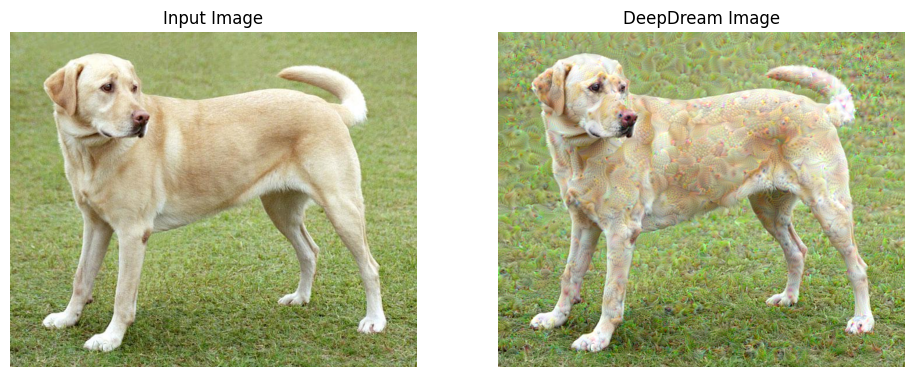

Running DeepDream with loss function: l2
Step 100, loss 2302876.5


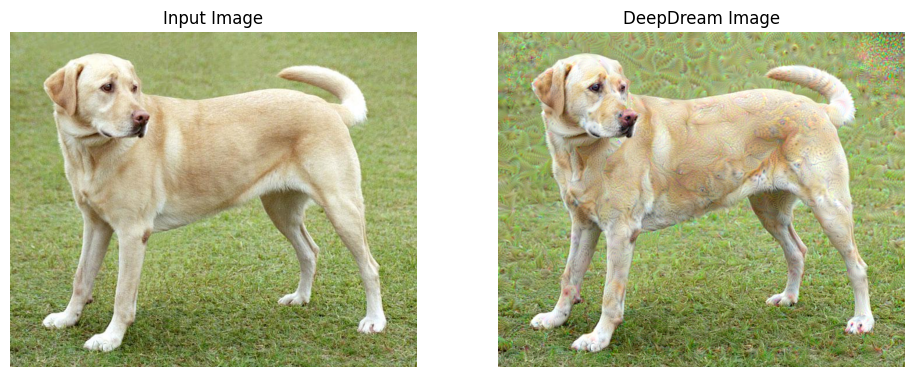

Running DeepDream with loss function: mse
Step 100, loss 3.7878410816192627


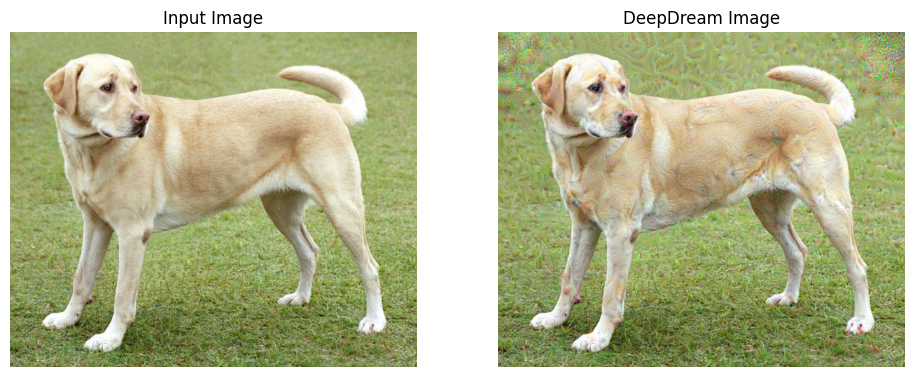

Running DeepDream with loss function: huber
Step 100, loss 0.8381026983261108


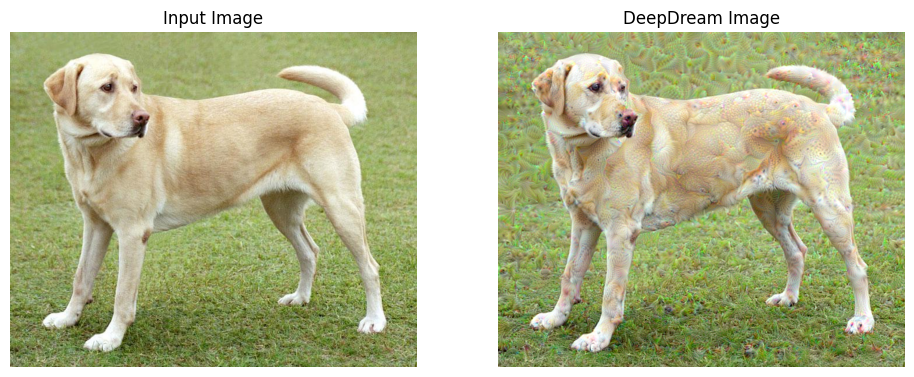

In [14]:
funcs = ['mean', 'l2', 'mse', 'huber']
for f in funcs:
    print(f'Running DeepDream with loss function: {f}')
    deep_dream(dog_img, model=mixed_dream_model, preprocess_mode='inceptionv3', steps=100, loss_func=f, verbose=1)

In [15]:
def deep_dream_with_pyramid(img, model, loss_func, preprocess_mode, steps=config['PYRAMID_STEPS'], verbose=1, plot_results=True):   
    base_shape = tf.cast(img.shape[:-1], tf.float32)

    for n in range(-2, 3):
        new_shape = tf.cast(base_shape*(config['PYRAMID_SIZE']**n), tf.int32)
        img = tf.image.resize(img, new_shape).numpy().astype('int')
        img = deep_dream(input_img=img,
                         model=model, 
                         preprocess_mode=preprocess_mode, 
                         steps=steps, 
                         lr=config['LR'], 
                         loss_func=loss_func, 
                         verbose=verbose,
                         plot_results=plot_results)
    return img

Step 100, loss 0.9809659719467163
Step 200, loss 1.1565922498703003


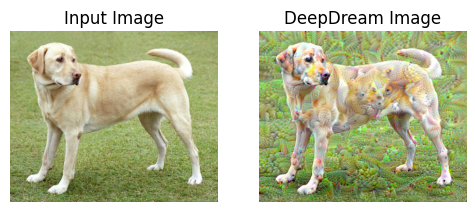

Step 100, loss 1.009723424911499
Step 200, loss 1.1577399969100952


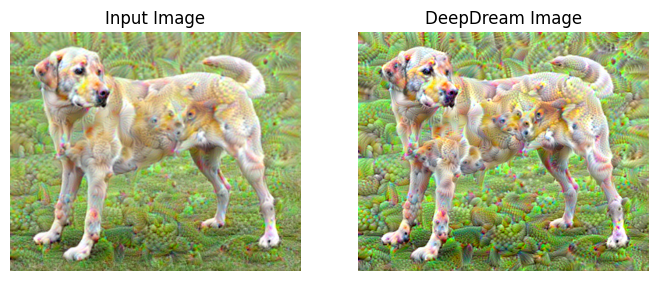

Step 100, loss 0.9766051769256592
Step 200, loss 1.125390887260437


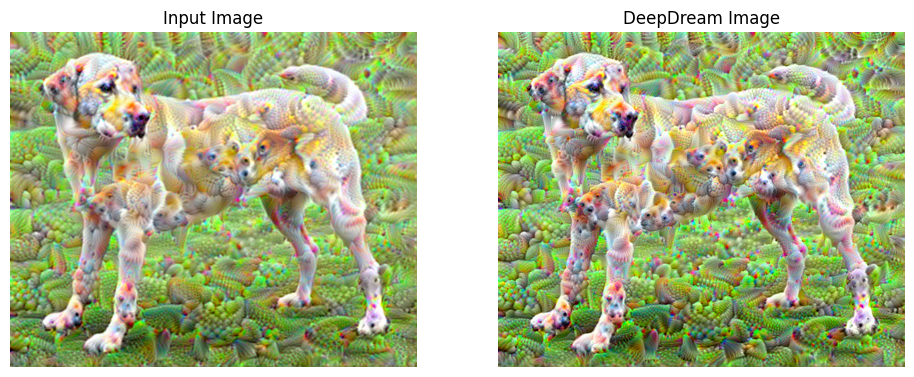

Step 100, loss 0.9634448289871216
Step 200, loss 1.1379948854446411


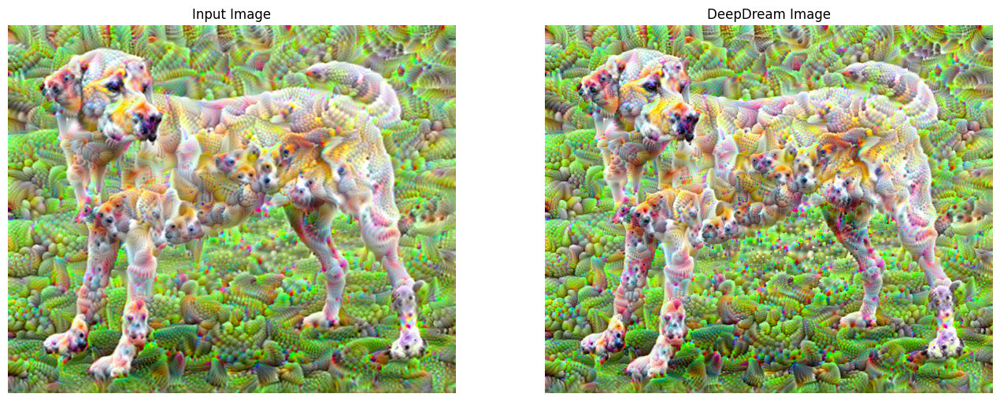

Step 100, loss 0.9915237426757812
Step 200, loss 1.1809481382369995


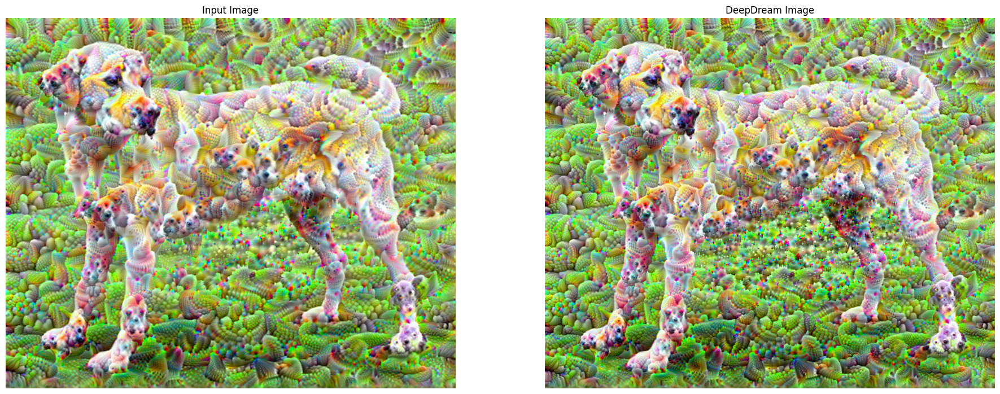

In [16]:
result = deep_dream_with_pyramid(dog_img, mixed_dream_model, 'huber', 'inceptionv3')

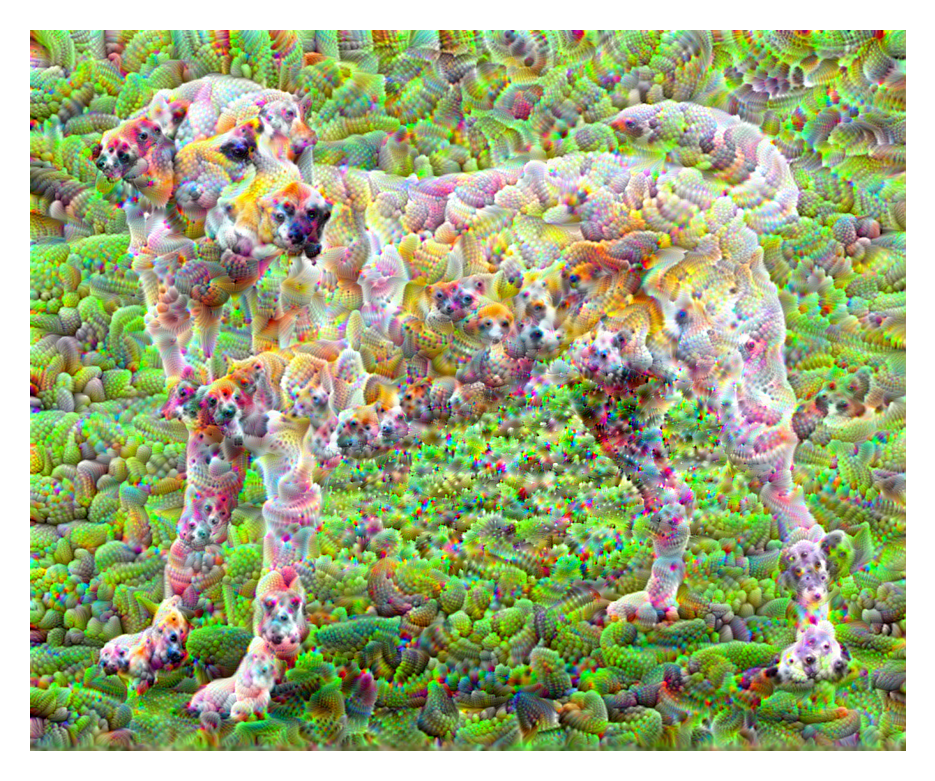

In [17]:
display_img(result)

Step 100, loss 0.7440630793571472
Step 200, loss 0.8748710751533508


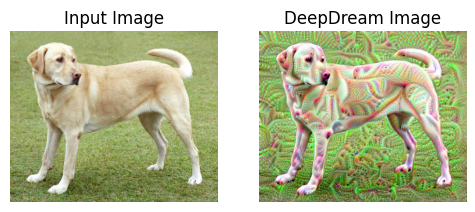

Step 100, loss 0.7893072962760925
Step 200, loss 0.9004251956939697


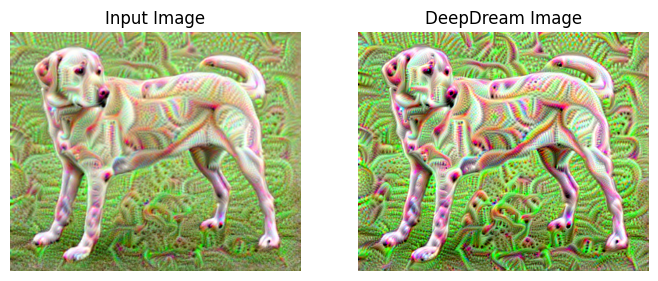

Step 100, loss 0.7720343470573425
Step 200, loss 0.8752360343933105


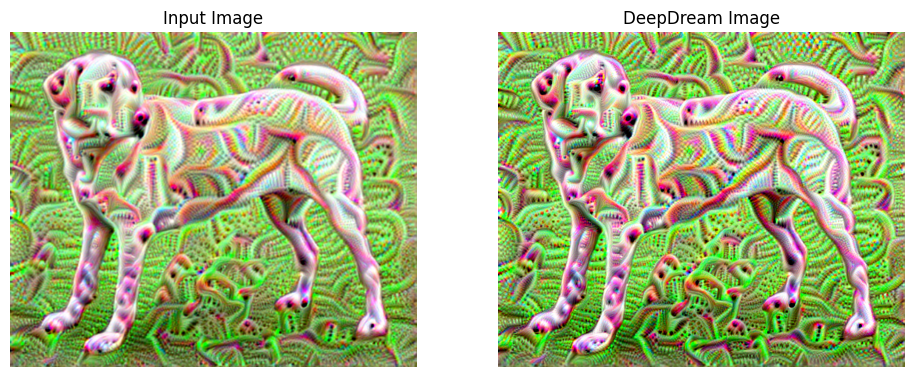

Step 100, loss 0.7632600665092468
Step 200, loss 0.8719267249107361


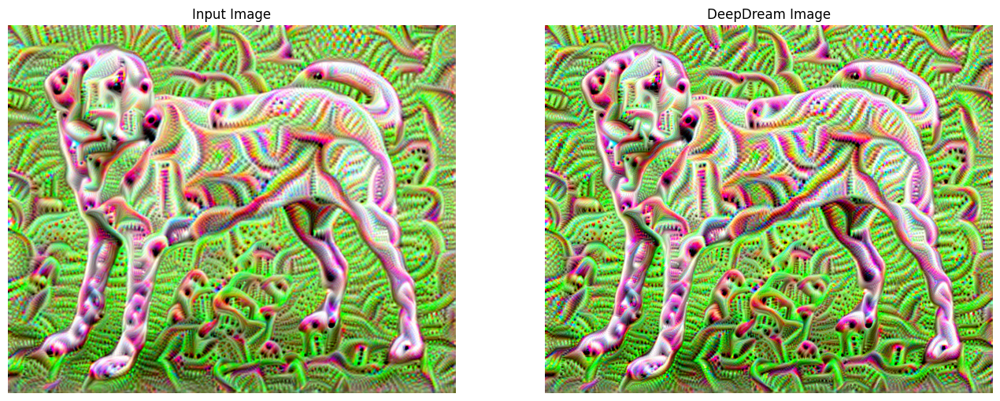

Step 100, loss 0.7561075687408447
Step 200, loss 0.8740290403366089


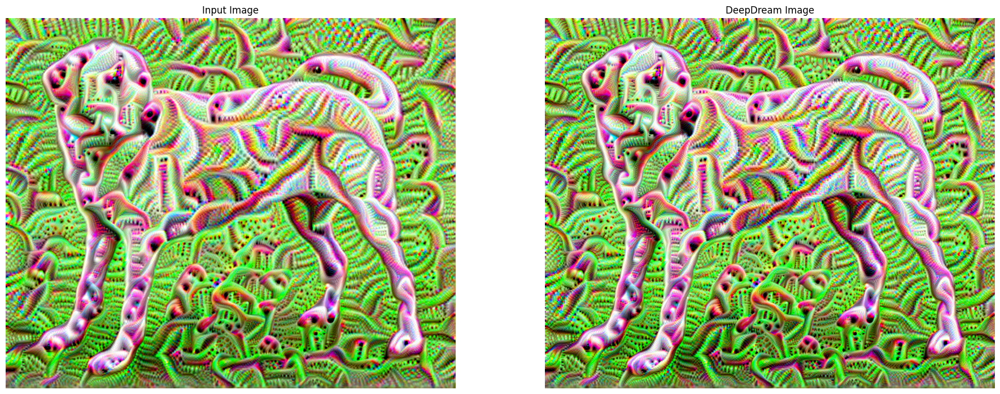

In [18]:
result = deep_dream_with_pyramid(dog_img, low_level_dream_model, 'huber', 'inceptionv3')

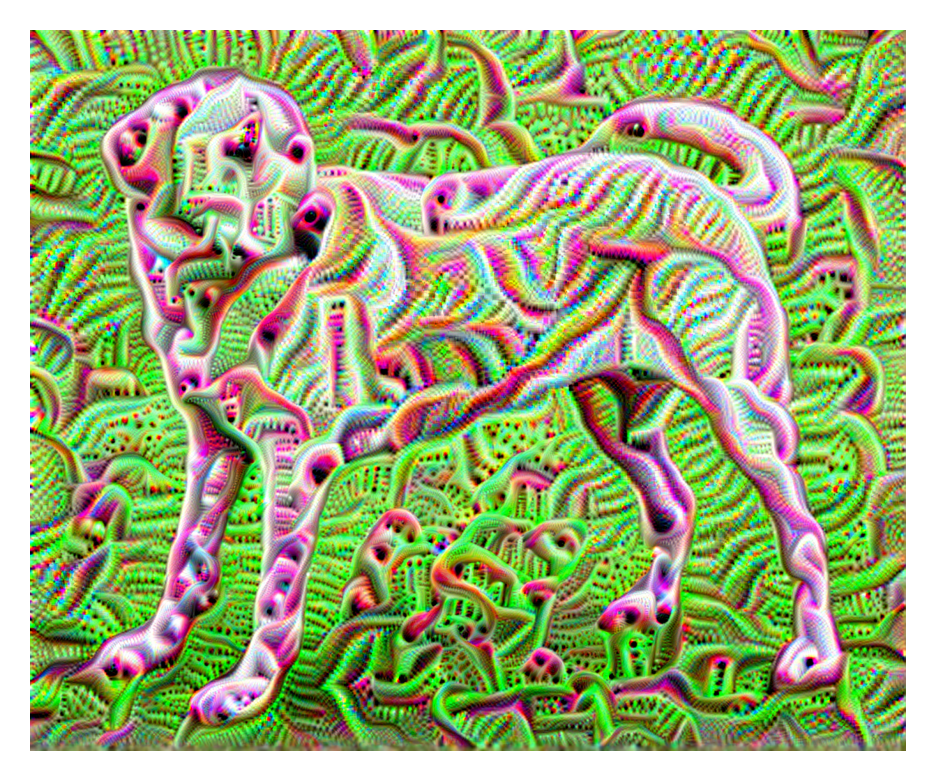

In [19]:
display_img(result)

Step 100, loss 0.1972869485616684
Step 200, loss 0.2543727159500122


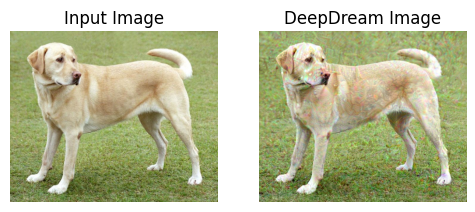

Step 100, loss 0.2676689028739929
Step 200, loss 0.3504449129104614


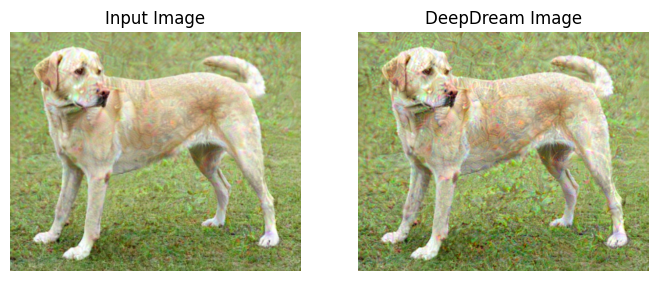

Step 100, loss 0.33209228515625
Step 200, loss 0.42154696583747864


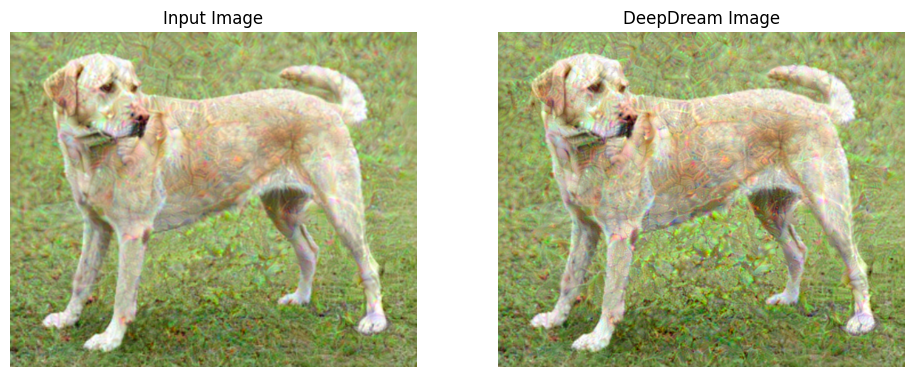

Step 100, loss 0.3593031167984009
Step 200, loss 0.45921704173088074


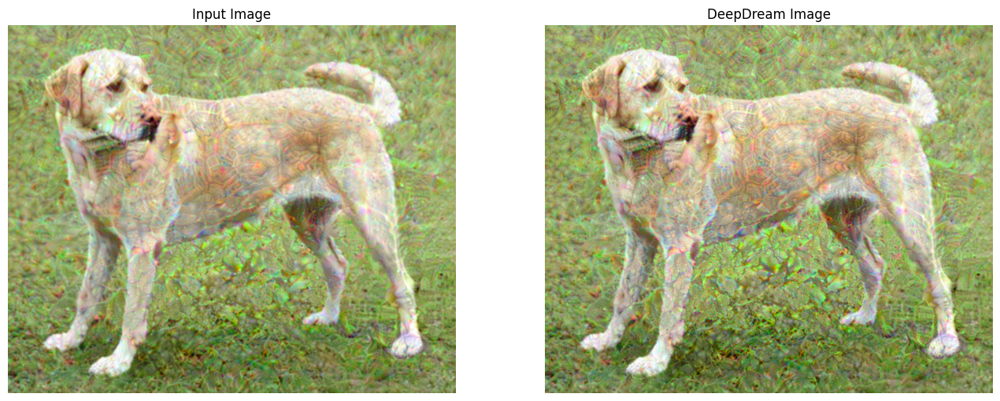

Step 100, loss 0.34201446175575256
Step 200, loss 0.4468565583229065


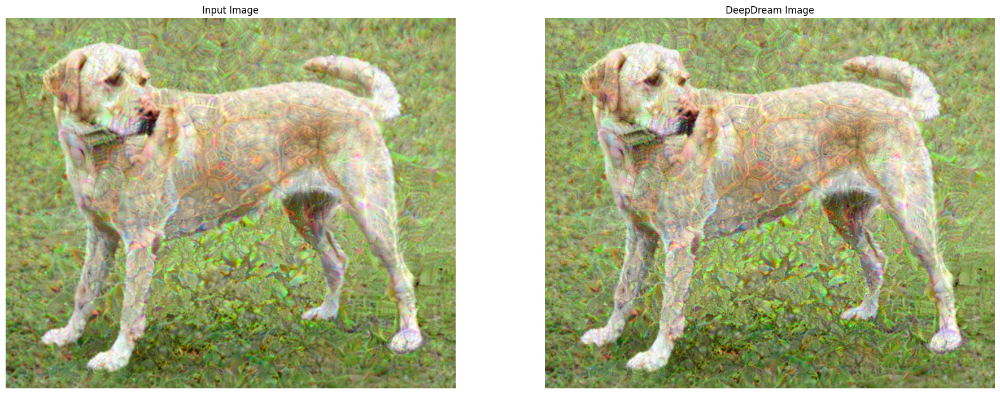

In [20]:
result = deep_dream_with_pyramid(dog_img, high_level_dream_model, 'huber', 'inceptionv3')

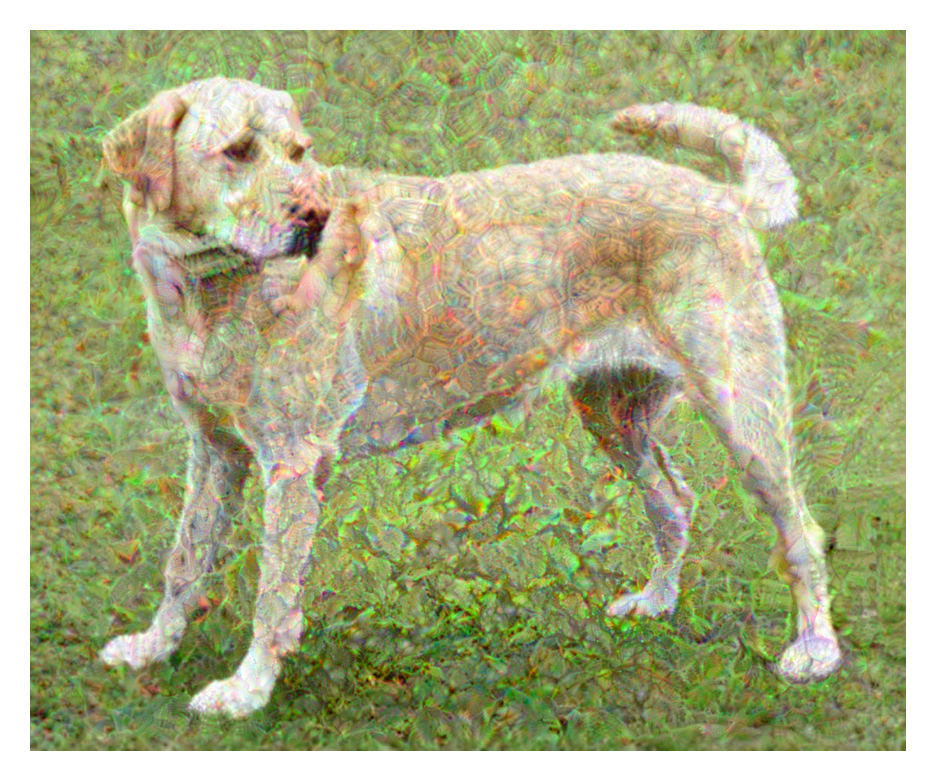

In [21]:
display_img(result)

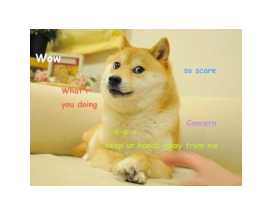

In [22]:
url = 'https://upload.wikimedia.org/wikipedia/en/5/5f/Original_Doge_meme.jpg'
doge = url_to_array(url)
display_img(doge)

Step 100, loss 1.1530697345733643
Step 200, loss 1.338948369026184


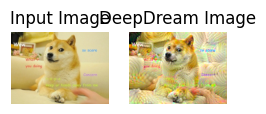

Step 100, loss 1.100760579109192
Step 200, loss 1.2580674886703491


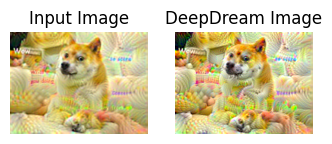

Step 100, loss 1.0151395797729492
Step 200, loss 1.1595662832260132


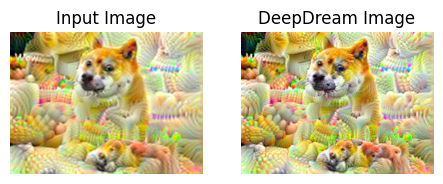

Step 100, loss 0.9489330649375916
Step 200, loss 1.08700430393219


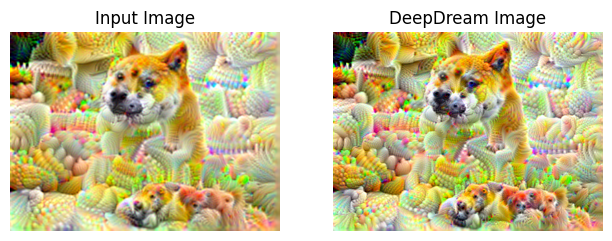

Step 100, loss 0.917788565158844
Step 200, loss 1.0535838603973389


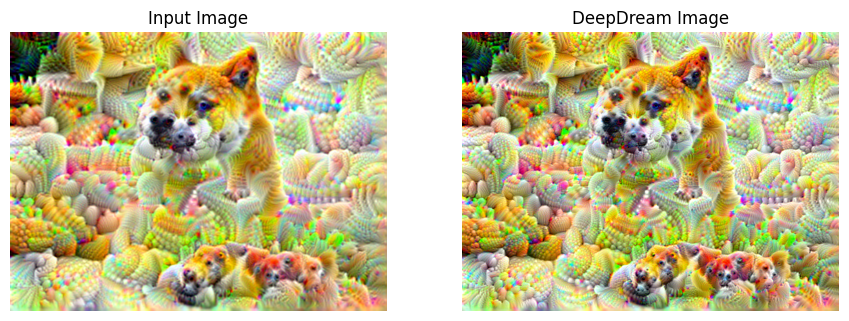

In [23]:
result = deep_dream_with_pyramid(doge, mixed_dream_model, 'huber', 'inceptionv3')

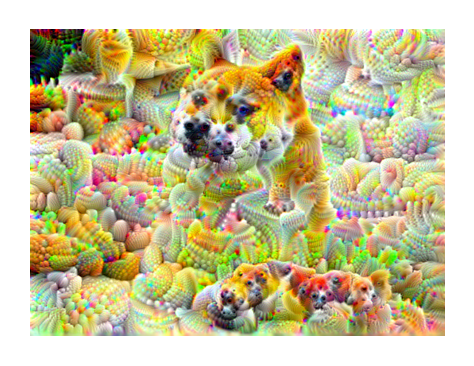

In [24]:
display_img(result)

# Zooming

In [41]:
display_img(result)

In [49]:
test_img = result

In [50]:
results = []
n = 60
for i in range(1, n+1):
    print(f'Generating frame {i}/{n}', end='\r')
    batch = tf.expand_dims(test_img, 0)
    test_img = tf.image.crop_and_resize(batch, 
                                        boxes=[[0.0, 0.0, 0.99, 0.99]], 
                                        # Maintain same size after crop
                                        crop_size=[batch.shape[1], batch.shape[2]], 
                                        box_indices=[0])
    test_img = tf.cast(tf.squeeze(test_img), tf.uint8)
    test_img = deep_dream_with_pyramid(test_img, 
                                       mixed_dream_model, 
                                       'huber', 
                                       'inceptionv3', 
                                       steps=75,
                                       verbose=0, 
                                       plot_results=False)
    test_img = tf.cast(tf.image.resize(test_img, (batch.shape[1], batch.shape[2])), tf.uint8)
    results.append(test_img)

In [51]:
%matplotlib qt

import matplotlib.animation as animation

fig = plt.figure() # make figure
plt.axis('off')
canvas = plt.imshow(results[0], vmin=0, vmax=255)

def draw_frame(i):
    canvas.set_array(results[i])
    return [canvas]

anim = animation.FuncAnimation(fig, draw_frame, frames=range(len(results)), interval=100, blit=True)
#anim

In [48]:
filename = "doge.gif" 
writer = animation.PillowWriter(fps=5) 
anim.save(filename, writer=writer)